<a href="https://colab.research.google.com/github/KozhevnikovAlexandr/OTALA-/blob/main/vgg16_bad_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [56]:
from tensorflow.python.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.keras.models import Sequential
from PIL import Image
from tensorflow.python.keras.layers import Activation, Dropout, Flatten, Dense
from tensorflow.python.keras.applications.vgg16 import VGG16
from tensorflow.python.keras.applications.vgg16 import preprocess_input, decode_predictions
from keras.optimizers import SGD
import cv2 as cv
from google.colab import files
import numpy as np
from google.colab import drive
import zipfile
import shutil
import matplotlib.pyplot as plt
from keras import losses
import os
from keras.optimizers import Adam

In [57]:
# Каталог с данными для обучения
train_dir = '/content/train'
# Каталог с данными для проверки
val_dir = '/content/test'
# Каталог с данными для тестирования
test_dir = '/content/val'
# Размеры изображения
img_width, img_height = 150, 150
# Размерность тензора на основе изображения для входных данных в нейронную сеть
input_shape = (img_width, img_height, 3)
# Размер мини-выборки 
batch_size = 100
# Количество изображений для обучения
nb_train_samples = 2000 
# Количество изображений для проверки
nb_validation_samples = 100
# Количество изображений для тестирования
nb_test_samples = 100
#Количество эпох
epochs_count = 10
#Количество нейронов на полносвязном слое
dense_count = 512

In [3]:
#подключение гугл диска
!mkdir /content/drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [4]:
#распаковка архивов
zip_file = '/content/drive/My Drive/set.zip'
z = zipfile.ZipFile(zip_file, 'r')
z.extractall()

In [5]:
zip_file = '/content/drive/My Drive/sorted.zip'
z = zipfile.ZipFile(zip_file, 'r')
z.extractall()

In [6]:
zip_file = '/content/drive/My Drive/work_test.zip'
z = zipfile.ZipFile(zip_file, 'r')
z.extractall()

In [7]:
!mkdir /content/train
!mkdir /content/train/phone
!mkdir /content/train/no_phone
!mkdir /content/val
!mkdir /content/val/phone
!mkdir /content/val/no_phone
!mkdir /content/test
!mkdir /content/test/phone
!mkdir /content/test/no_phone

In [8]:
#функция пермещает и соритрует фото по каталогам для генераторов
def move_files(from_dir, to_train, to_val, to_test, format, train_count):
  val_count = 0
  test_count = 0
  current_train_count = 0
  for root, dirs, files in os.walk(from_dir):
    for file in files:
      if (file.endswith(format)):
        if val_count < nb_validation_samples // 2:
          val_count += 1
          os.rename(os.path.join(from_dir, file), os.path.join(to_val, file))
          continue
        if test_count < nb_test_samples // 2:
          test_count += 1
          os.rename(os.path.join(from_dir, file), os.path.join(to_test, file)) 
          continue
        if current_train_count < train_count:
          current_train_count += 1
          os.rename(os.path.join(from_dir, file), os.path.join(to_train, file))
          continue

In [9]:
move_files('/content/set/', '/content/train/phone/', '/content/val/phone/', '/content/test/phone/', '.jpg', 1000)

In [10]:
move_files('/content/sorted/', '/content/train/no_phone/', '/content/val/no_phone/', '/content/test/no_phone/', '.JPEG', 1000)

In [58]:
#инициализация готовой части сети
vgg16_net = VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
#отключение обучения уже обученной части
vgg16_net.trainable = False

In [59]:
#инициализация сети, добавление слоев
model = Sequential()
model.add(vgg16_net)
model.add(Flatten())
model.add(Dense(dense_count))
model.add(Activation('relu'))
model.add(Dropout(0.5))
model.add(Dense(2))
model.add(Activation('softmax'))

In [60]:
#компиляция модели
#фунуция ошибок - среднекватратичная 
#оптимизатор Adam
model.compile(loss=losses.mean_squared_error,
              optimizer=Adam(lr=1e-5), 
              metrics=['accuracy'])

In [61]:
#создание генератора, помещаем все пиксели изображения в диапазон от 0 до 255
datagen = ImageDataGenerator(rescale=1. / 255)

In [62]:
#генератор данных для обучения
train_generator = datagen.flow_from_directory(
    train_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical')

Found 2000 images belonging to 2 classes.


In [63]:
#генератор данных для проверки
val_generator = datagen.flow_from_directory(
    val_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical')

Found 100 images belonging to 2 classes.


In [64]:
#генератор данных для тестиования
test_generator = datagen.flow_from_directory(
    test_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical')

Found 100 images belonging to 2 classes.


In [65]:
#генератор рабочих данных для тестиования
work_generator = datagen.flow_from_directory(
    '/content/work_test',
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='binary')

Found 163 images belonging to 2 classes.


In [66]:
model.fit_generator(
    train_generator,
    steps_per_epoch=nb_train_samples // batch_size,
    epochs=epochs_count,
    validation_data=val_generator,
    validation_steps=nb_validation_samples // batch_size)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/10
20/20 [==============================] - 11s 537ms/step - loss: 0.2530 - accuracy: 0.6076 - val_loss: 0.0859 - val_accuracy: 0.9300
Epoch 2/10
20/20 [==============================] - 10s 505ms/step - loss: 0.1245 - accuracy: 0.8252 - val_loss: 0.0355 - val_accuracy: 0.9800
Epoch 3/10
20/20 [==============================] - 10s 504ms/step - loss: 0.0603 - accuracy: 0.9247 - val_loss: 0.0222 - val_accuracy: 0.9800
Epoch 4/10
20/20 [==============================] - 10s 503ms/step - loss: 0.0415 - accuracy: 0.9562 - val_loss: 0.0156 - val_accuracy: 0.9900
Epoch 5/10
20/20 [==============================] - 10s 500ms/step - loss: 0.0310 - accuracy: 0.9671 - val_loss: 0.0128 - val_accuracy: 0.9900
Epoch 6/10
20/20 [==============================] - 10s 502ms/step - loss: 0.0260 - accuracy: 0.9741 - val_loss: 0.0103 - val_accuracy: 0.9900
Epoch 7/10
20/20 [==============================] - 10s 500ms/step - loss: 0.0225 - accuracy: 0.9746 - val_loss: 0.0084 - val_accuracy: 1.0000

In [67]:
scores = model.evaluate_generator(test_generator, nb_test_samples // batch_size)
print("Точность на тестовых данных (синтетика): %.2f%%" % (scores[1]*100))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1877: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Точность на тестовых данных (синтетика): 98.00%


In [68]:
scores = model.evaluate_generator(work_generator, 164 // batch_size)
print("Точность на рабочих данных (с вебки): %.2f%%" % (scores[1]*100))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1877: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Точность на рабочих данных (с вебки): 100.00%


In [72]:
def get_predict(file):
  i = Image.open(file).convert('RGB')
  i = i.resize((150, 150))
  i = np.asarray(i)
  i = np.expand_dims(i, axis=0)
  r = model.predict(i)
  return (model.predict(i), np.argmax(r, axis=1))

(array([[4.1719803e-37, 1.0000000e+00]], dtype=float32), array([1]))


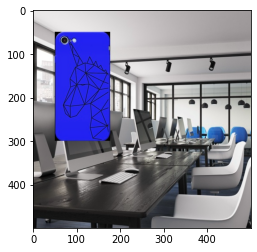

In [77]:
path = '/content/train/phone/1019.jpg'
print(get_predict(path))
im = cv.imread(path)
plt.imshow(im)
plt.show()

(array([[0.99394023, 0.00605972]], dtype=float32), array([0]))


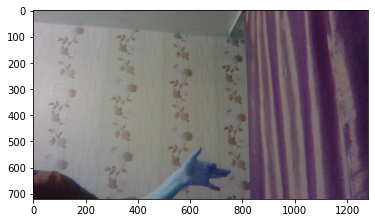

In [73]:
path = '/content/work_test/no_phone/3.jpg'
print(get_predict(path))
im = cv.imread(path)
plt.imshow(im)
plt.show()

(array([[0.64464223, 0.35535774]], dtype=float32), array([0]))


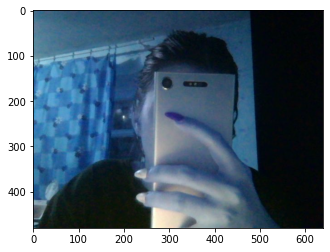

In [74]:
path = '/content/work_test/phone/1 (4).jpg'
print(get_predict(path))
im = cv.imread(path)
plt.imshow(im)
plt.show()

(array([[9.9998522e-01, 1.4837703e-05]], dtype=float32), array([0]))


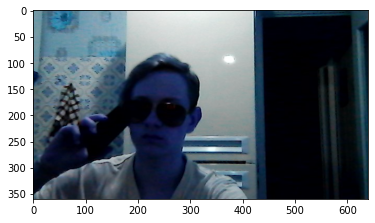

(array([[1.0000000e+00, 1.5641705e-18]], dtype=float32), array([0]))


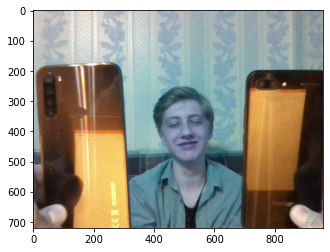

(array([[7.788629e-09, 1.000000e+00]], dtype=float32), array([1]))


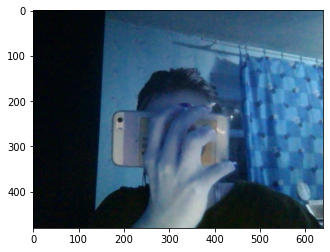

(array([[0.8807388 , 0.11926119]], dtype=float32), array([0]))


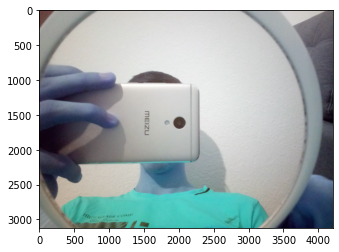

(array([[1.0000000e+00, 1.5754311e-11]], dtype=float32), array([0]))


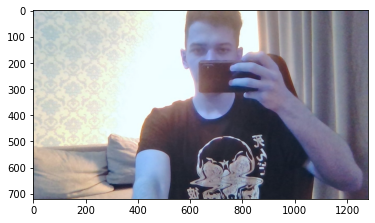

(array([[0.9915092, 0.0084908]], dtype=float32), array([0]))


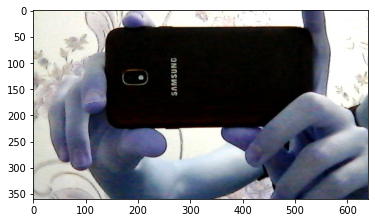

(array([[1.0000000e+00, 4.3595123e-12]], dtype=float32), array([0]))


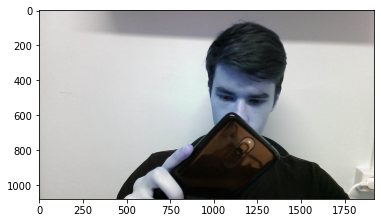

(array([[1.0000000e+00, 1.6321965e-20]], dtype=float32), array([0]))


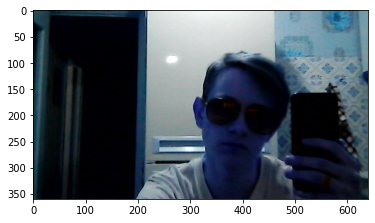

(array([[0.17107011, 0.8289299 ]], dtype=float32), array([1]))


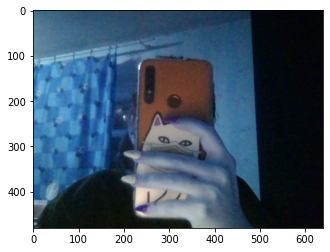

(array([[1.0000000e+00, 1.2580493e-27]], dtype=float32), array([0]))


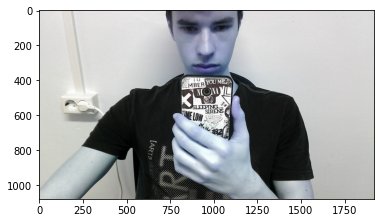

(array([[1.0000000e+00, 7.7145887e-16]], dtype=float32), array([0]))


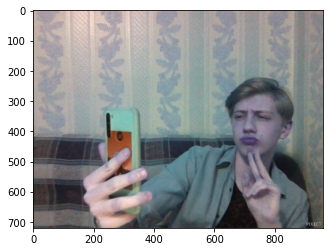

(array([[0.9314983 , 0.06850174]], dtype=float32), array([0]))


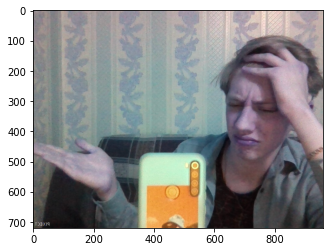

(array([[1.0000000e+00, 2.8045859e-11]], dtype=float32), array([0]))


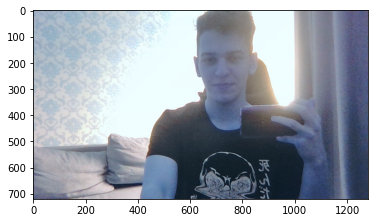

(array([[0.9935969 , 0.00640304]], dtype=float32), array([0]))


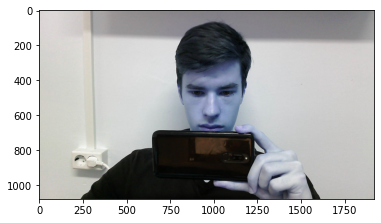

(array([[1.0000000e+00, 1.4712886e-12]], dtype=float32), array([0]))


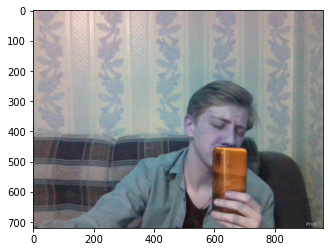

(array([[0.9720748 , 0.02792514]], dtype=float32), array([0]))


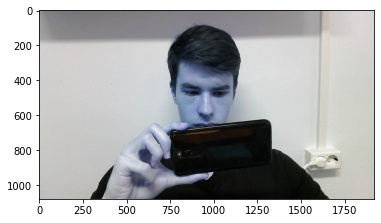

(array([[0.6354013, 0.3645987]], dtype=float32), array([0]))


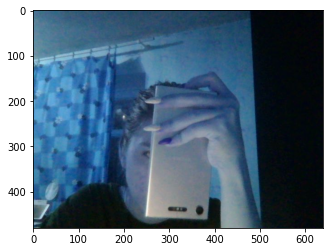

(array([[1.0000000e+00, 7.3124304e-20]], dtype=float32), array([0]))


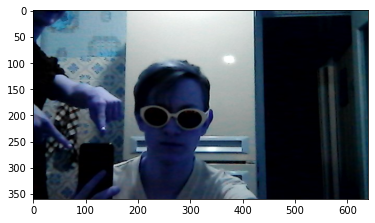

(array([[9.999832e-01, 1.683042e-05]], dtype=float32), array([0]))


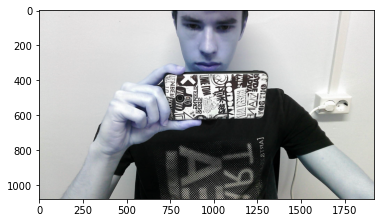

(array([[9.999999e-01, 5.968814e-08]], dtype=float32), array([0]))


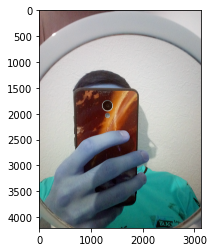

(array([[1.0000000e+00, 1.0821466e-12]], dtype=float32), array([0]))


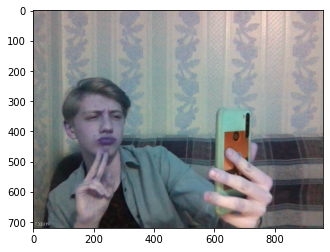

(array([[1.0491131e-11, 1.0000000e+00]], dtype=float32), array([1]))


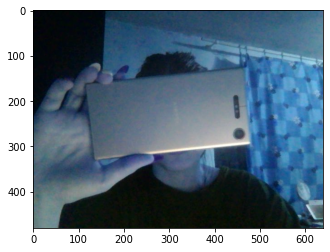

(array([[0.9919743 , 0.00802569]], dtype=float32), array([0]))


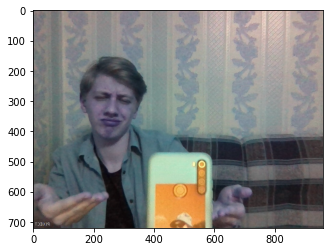

(array([[1.0000000e+00, 5.7819683e-25]], dtype=float32), array([0]))


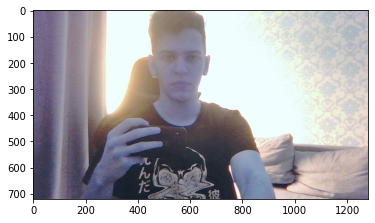

(array([[9.9998224e-01, 1.7810693e-05]], dtype=float32), array([0]))


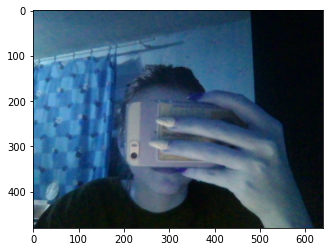

(array([[1.0000000e+00, 1.6024557e-10]], dtype=float32), array([0]))


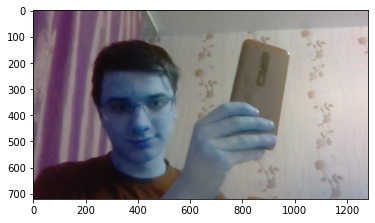

(array([[1.0000000e+00, 4.5783918e-21]], dtype=float32), array([0]))


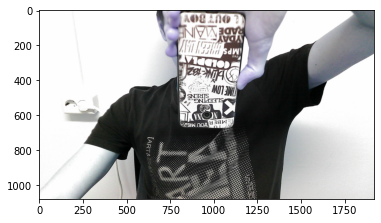

(array([[1.0000000e+00, 4.3429196e-17]], dtype=float32), array([0]))


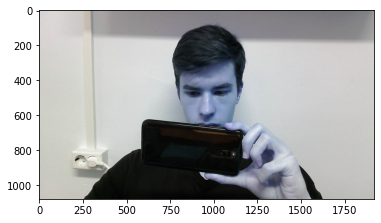

(array([[1.0000000e+00, 3.0747246e-10]], dtype=float32), array([0]))


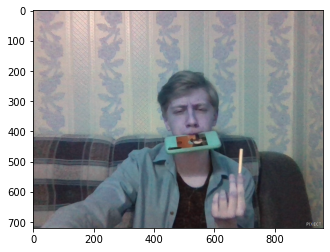

(array([[9.994935e-01, 5.065507e-04]], dtype=float32), array([0]))


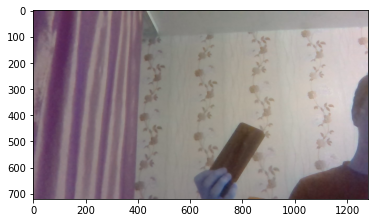

(array([[1.000000e+00, 3.315676e-08]], dtype=float32), array([0]))


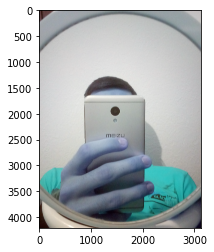

(array([[1.0000000e+00, 2.1196748e-15]], dtype=float32), array([0]))


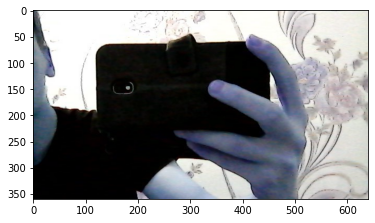

(array([[9.9972063e-01, 2.7939683e-04]], dtype=float32), array([0]))


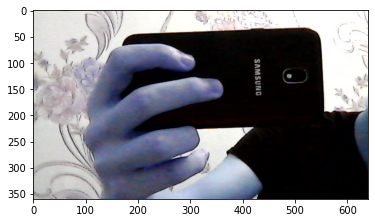

(array([[9.995028e-01, 4.972038e-04]], dtype=float32), array([0]))


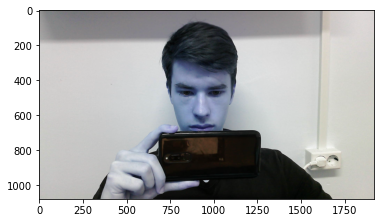

(array([[1.0000000e+00, 6.3635373e-18]], dtype=float32), array([0]))


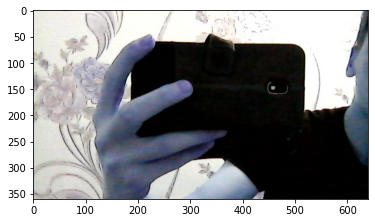

(array([[9.9999690e-01, 3.0598935e-06]], dtype=float32), array([0]))


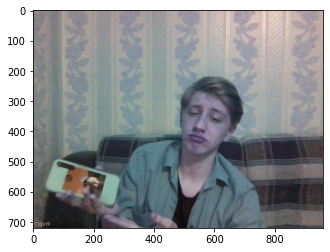

(array([[1.0000000e+00, 1.1267258e-23]], dtype=float32), array([0]))


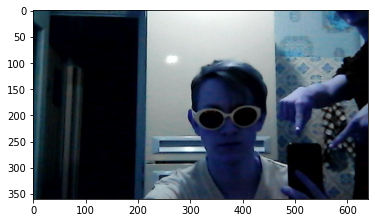

(array([[0.99758995, 0.00241012]], dtype=float32), array([0]))


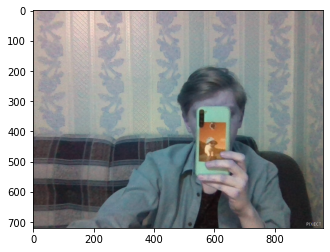

(array([[9.9992645e-01, 7.3496522e-05]], dtype=float32), array([0]))


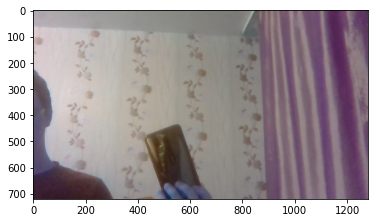

(array([[1.0000000e+00, 1.9297488e-24]], dtype=float32), array([0]))


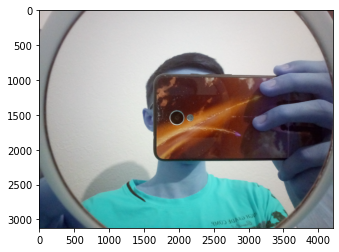

(array([[0.9985713 , 0.00142866]], dtype=float32), array([0]))


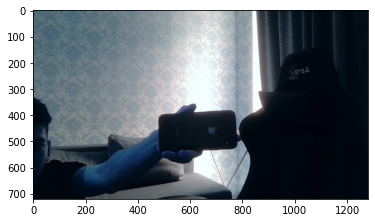

(array([[1.0000000e+00, 1.0454446e-13]], dtype=float32), array([0]))


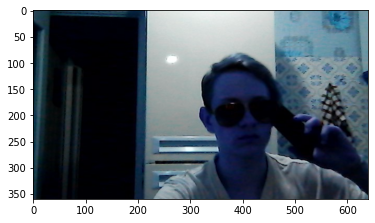

(array([[2.7814656e-04, 9.9972183e-01]], dtype=float32), array([1]))


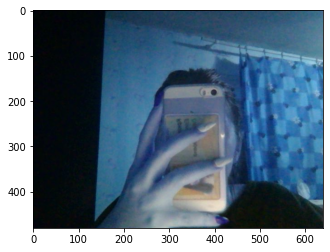

(array([[9.9999988e-01, 1.2714735e-07]], dtype=float32), array([0]))


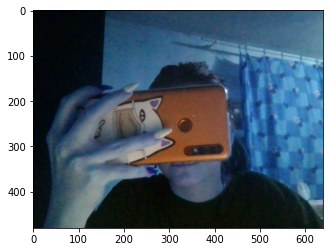

(array([[9.9932575e-01, 6.7427952e-04]], dtype=float32), array([0]))


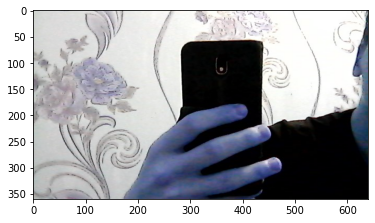

(array([[9.9999571e-01, 4.2553525e-06]], dtype=float32), array([0]))


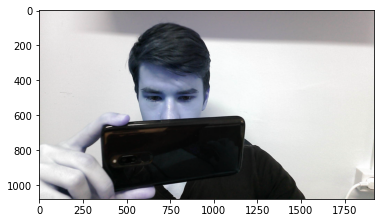

(array([[1.0000000e+00, 1.2512855e-21]], dtype=float32), array([0]))


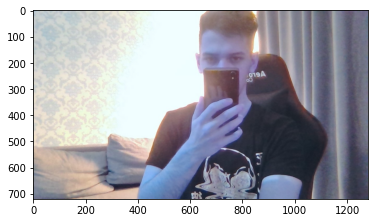

(array([[1.0000000e+00, 3.5063765e-19]], dtype=float32), array([0]))


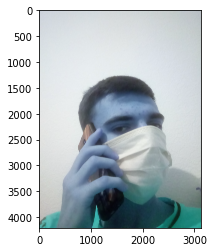

(array([[1.000000e+00, 4.128513e-11]], dtype=float32), array([0]))


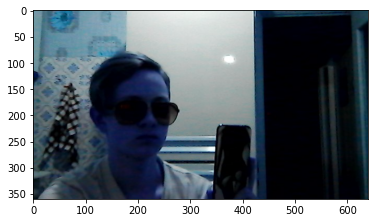

(array([[9.9993896e-01, 6.1060309e-05]], dtype=float32), array([0]))


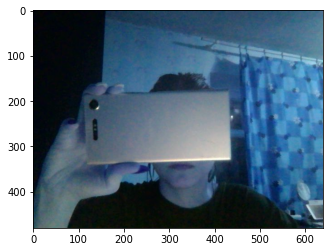

(array([[1.0000000e+00, 3.3416762e-11]], dtype=float32), array([0]))


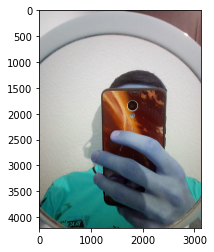

(array([[1.000000e+00, 3.361817e-24]], dtype=float32), array([0]))


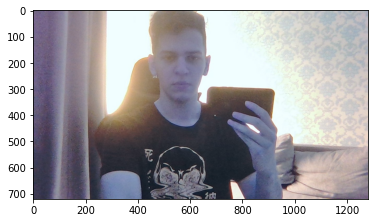

(array([[9.9999988e-01, 1.4421482e-07]], dtype=float32), array([0]))


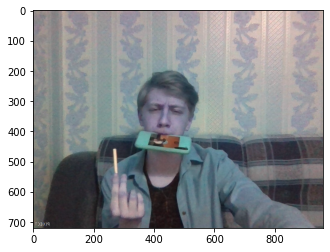

(array([[1.0000000e+00, 1.3165106e-18]], dtype=float32), array([0]))


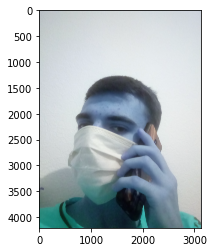

(array([[9.9999845e-01, 1.5038934e-06]], dtype=float32), array([0]))


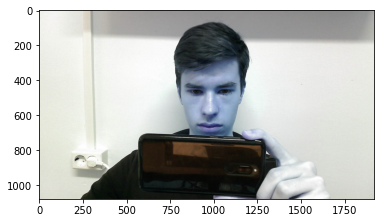

(array([[9.999933e-01, 6.707010e-06]], dtype=float32), array([0]))


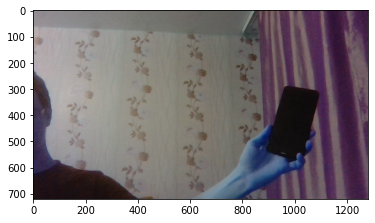

(array([[9.9999988e-01, 9.3382866e-08]], dtype=float32), array([0]))


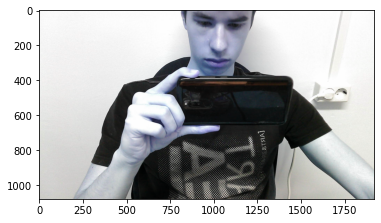

(array([[1.000000e+00, 1.333528e-27]], dtype=float32), array([0]))


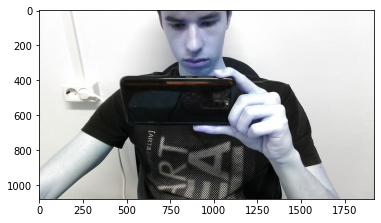

(array([[1., 0.]], dtype=float32), array([0]))


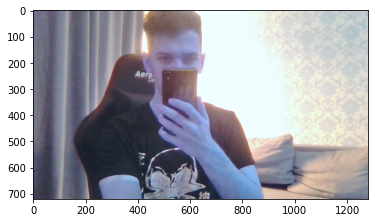

(array([[1.0000000e+00, 1.5443025e-11]], dtype=float32), array([0]))


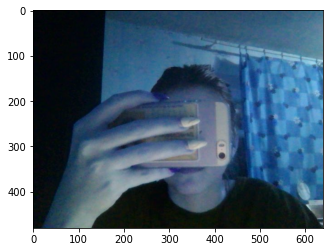

(array([[0.06341469, 0.9365853 ]], dtype=float32), array([1]))


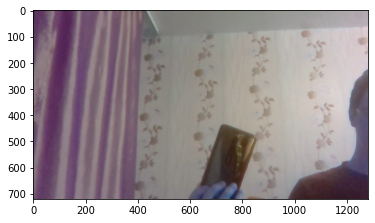

(array([[4.8370995e-18, 1.0000000e+00]], dtype=float32), array([1]))


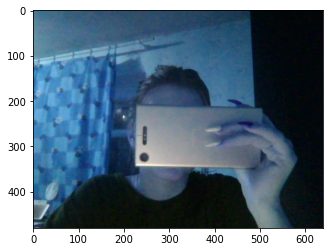

(array([[0.9946896 , 0.00531039]], dtype=float32), array([0]))


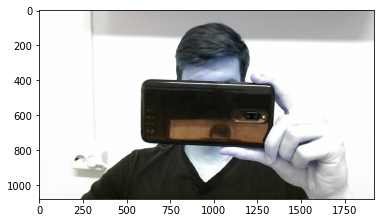

(array([[0.00211891, 0.9978811 ]], dtype=float32), array([1]))


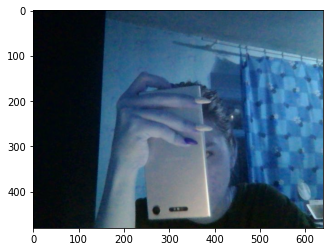

(array([[1.0000000e+00, 2.0790038e-28]], dtype=float32), array([0]))


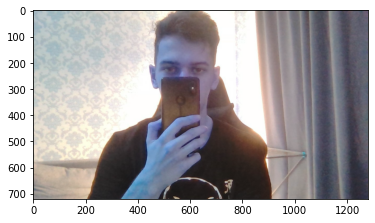

(array([[9.9998891e-01, 1.1036206e-05]], dtype=float32), array([0]))


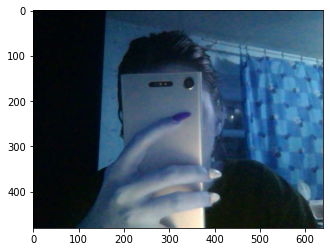

(array([[1.0000000e+00, 1.4891895e-14]], dtype=float32), array([0]))


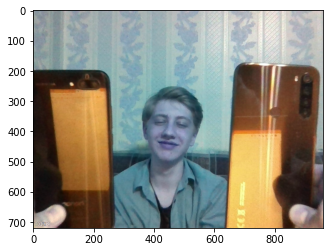

(array([[0.64464223, 0.35535774]], dtype=float32), array([0]))


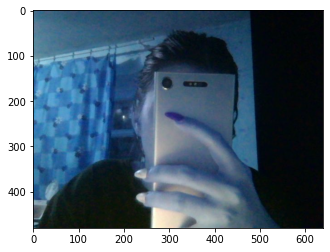

(array([[1.0000000e+00, 1.4837335e-23]], dtype=float32), array([0]))


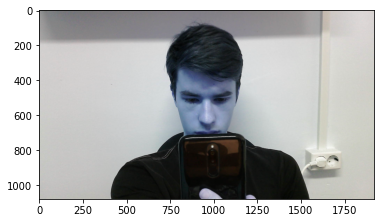

(array([[1.0000000e+00, 1.3306255e-36]], dtype=float32), array([0]))


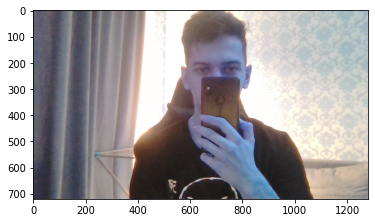

(array([[1.000000e+00, 4.778217e-12]], dtype=float32), array([0]))


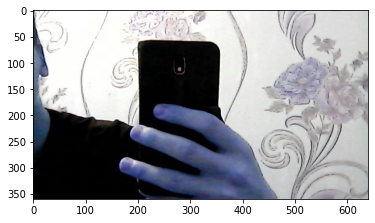

(array([[1.0000000e+00, 6.5070482e-09]], dtype=float32), array([0]))


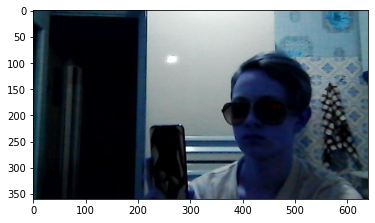

(array([[9.9985147e-01, 1.4849484e-04]], dtype=float32), array([0]))


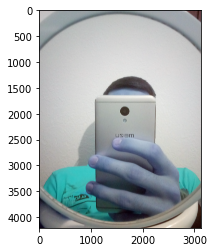

(array([[0.99579936, 0.00420063]], dtype=float32), array([0]))


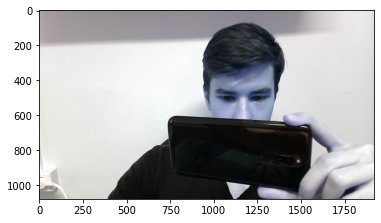

(array([[1.000000e+00, 1.328515e-22]], dtype=float32), array([0]))


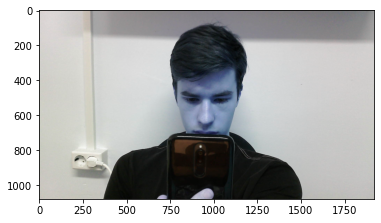

(array([[7.782393e-09, 1.000000e+00]], dtype=float32), array([1]))


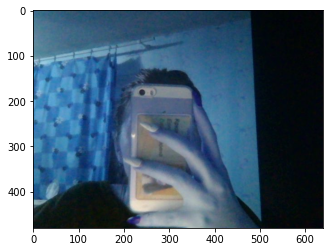

(array([[9.5445665e-11, 1.0000000e+00]], dtype=float32), array([1]))


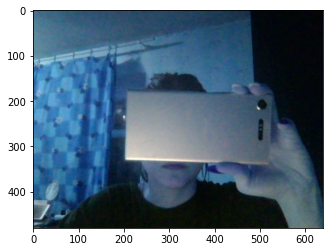

(array([[9.9999857e-01, 1.4740014e-06]], dtype=float32), array([0]))


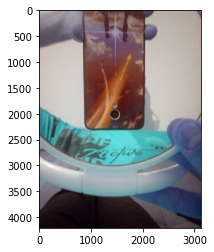

(array([[1.0000000e+00, 4.4480235e-12]], dtype=float32), array([0]))


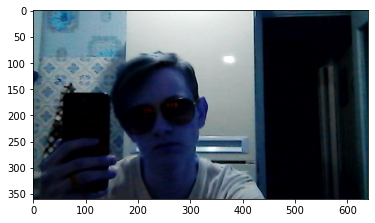

(array([[0.03492361, 0.9650764 ]], dtype=float32), array([1]))


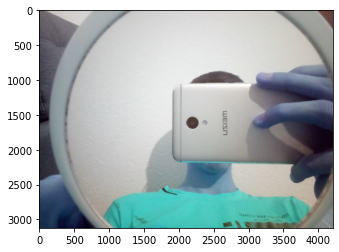

(array([[1.0000000e+00, 8.4979004e-17]], dtype=float32), array([0]))


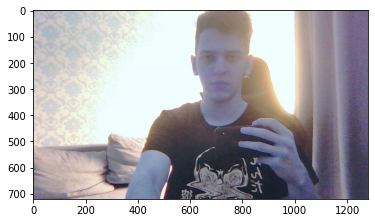

(array([[1.0000000e+00, 3.6857136e-19]], dtype=float32), array([0]))


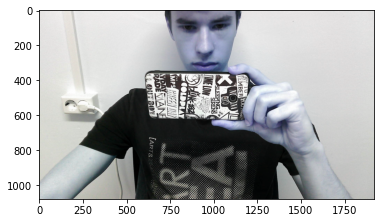

(array([[9.9999917e-01, 8.2451584e-07]], dtype=float32), array([0]))


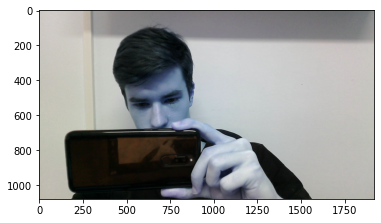

(array([[1.000000e+00, 7.779774e-18]], dtype=float32), array([0]))


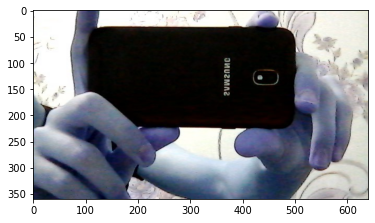

(array([[1.0000000e+00, 1.2691878e-29]], dtype=float32), array([0]))


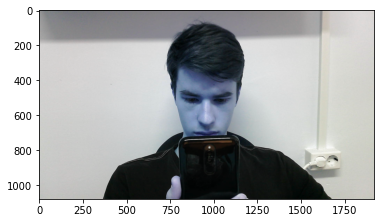

(array([[1.0000000e+00, 7.0986785e-09]], dtype=float32), array([0]))


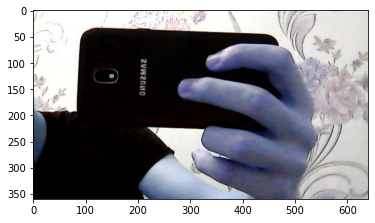

(array([[9.999913e-01, 8.650154e-06]], dtype=float32), array([0]))


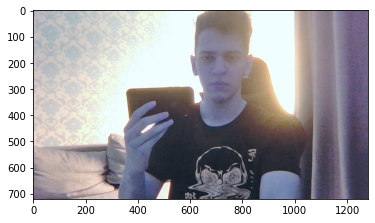

(array([[0.009065, 0.990935]], dtype=float32), array([1]))


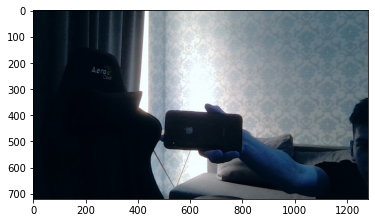

(array([[1.000000e+00, 3.344463e-22]], dtype=float32), array([0]))


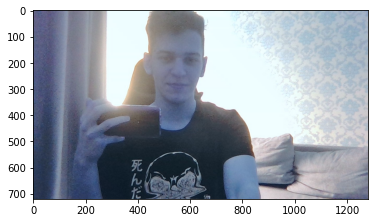

(array([[9.9994826e-01, 5.1728221e-05]], dtype=float32), array([0]))


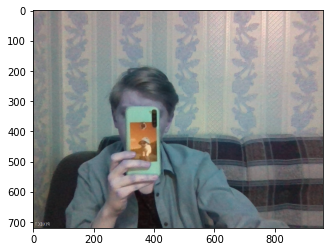

(array([[1.00000000e+00, 1.29249434e-20]], dtype=float32), array([0]))


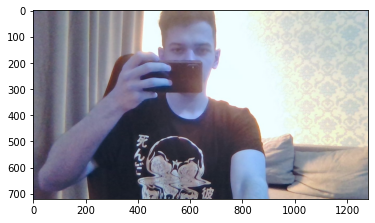

(array([[1.0000000e+00, 1.3811513e-31]], dtype=float32), array([0]))


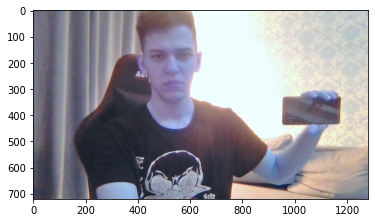

(array([[9.999621e-01, 3.792316e-05]], dtype=float32), array([0]))


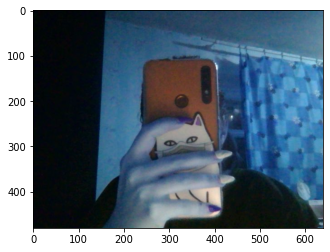

(array([[1.00000e+00, 4.60518e-11]], dtype=float32), array([0]))


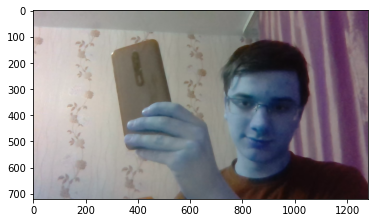

(array([[6.902599e-05, 9.999310e-01]], dtype=float32), array([1]))


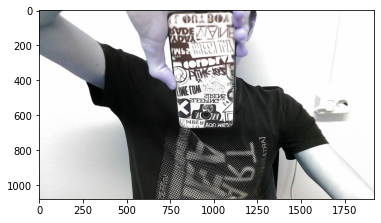

(array([[1.0000000e+00, 2.8696223e-22]], dtype=float32), array([0]))


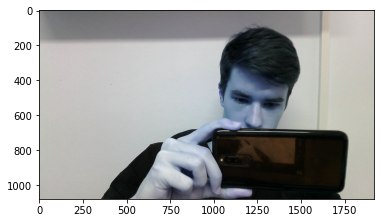

(array([[1.0000000e+00, 1.4123777e-10]], dtype=float32), array([0]))


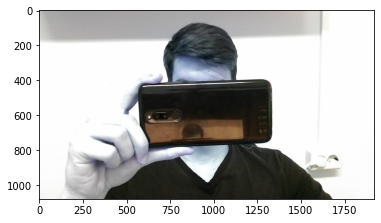

(array([[1.0000000e+00, 2.8728542e-14]], dtype=float32), array([0]))


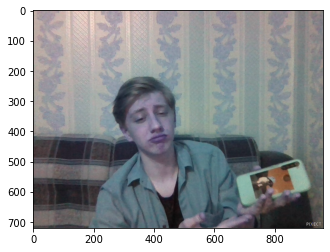

(array([[1.0000000e+00, 2.6998305e-26]], dtype=float32), array([0]))


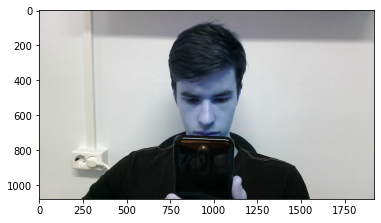

(array([[9.9999976e-01, 2.2827858e-07]], dtype=float32), array([0]))


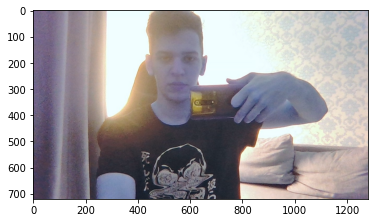

(array([[1.9159655e-04, 9.9980837e-01]], dtype=float32), array([1]))


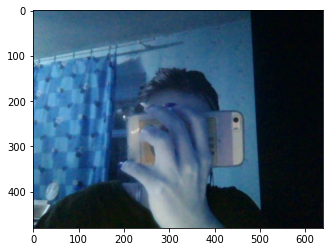

(array([[9.9992204e-01, 7.8008758e-05]], dtype=float32), array([0]))


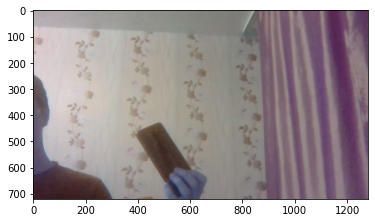

(array([[1.0540734e-07, 9.9999988e-01]], dtype=float32), array([1]))


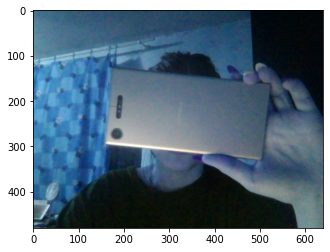

(array([[1.0000000e+00, 3.7911535e-11]], dtype=float32), array([0]))


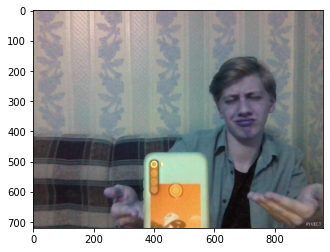

(array([[1.000000e+00, 7.432081e-15]], dtype=float32), array([0]))


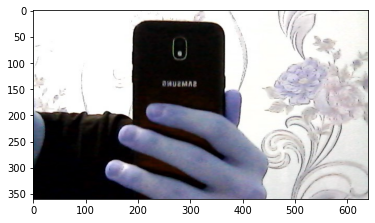

(array([[0.8246244 , 0.17537558]], dtype=float32), array([0]))


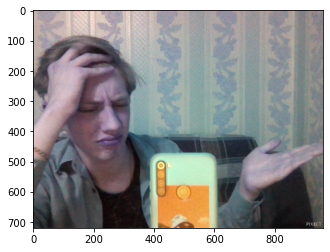

(array([[9.9999952e-01, 4.3090438e-07]], dtype=float32), array([0]))


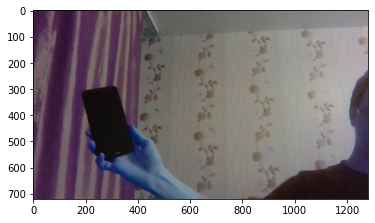

(array([[1.0000000e+00, 3.2776773e-20]], dtype=float32), array([0]))


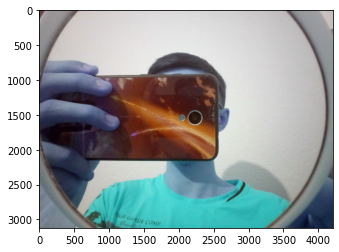

(array([[9.9999857e-01, 1.4655326e-06]], dtype=float32), array([0]))


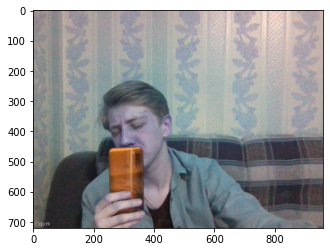

(array([[1.000000e+00, 4.391872e-22]], dtype=float32), array([0]))


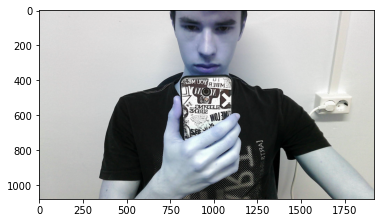

(array([[1.000000e+00, 6.341324e-23]], dtype=float32), array([0]))


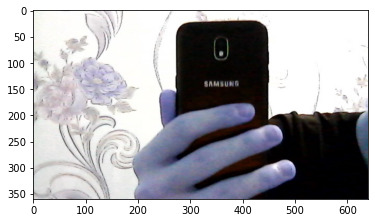

(array([[0.945354  , 0.05464599]], dtype=float32), array([0]))


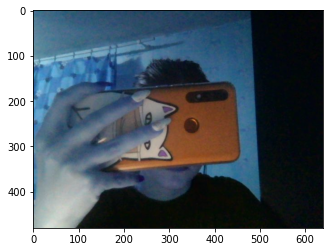

(array([[5.4050524e-11, 1.0000000e+00]], dtype=float32), array([1]))


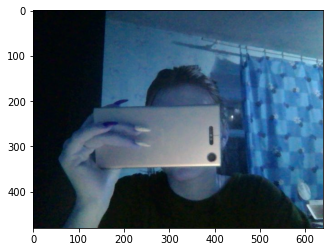

(array([[1.0000000e+00, 2.5651358e-14]], dtype=float32), array([0]))


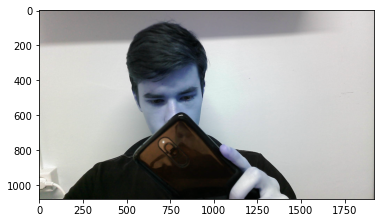

(array([[0.580556  , 0.41944405]], dtype=float32), array([0]))


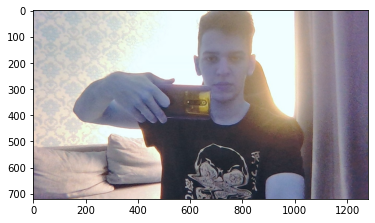

(array([[1.0000000e+00, 1.1607005e-10]], dtype=float32), array([0]))


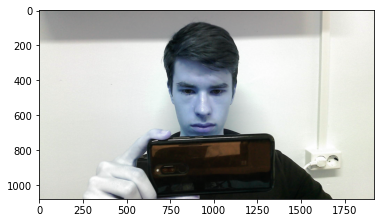

(array([[1.000000e+00, 6.436442e-24]], dtype=float32), array([0]))


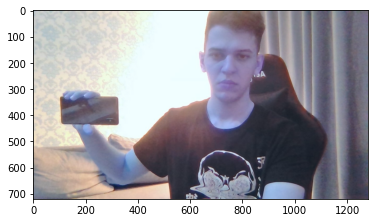

In [75]:
path = '/content/work_test/phone'
for root, dirs, files in os.walk(path):
    for file in files:
      p = os.path.join(path, file)
      print(get_predict(p))
      im = cv.imread(p)
      plt.imshow(im)
      plt.show()

(array([[1.0000000e+00, 2.5092383e-11]], dtype=float32), array([0]))


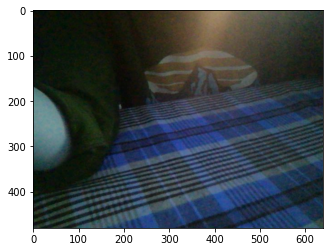

(array([[1.000000e+00, 4.495497e-12]], dtype=float32), array([0]))


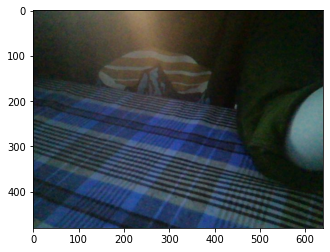

(array([[1.0000000e+00, 7.2163103e-10]], dtype=float32), array([0]))


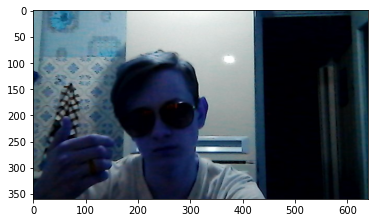

(array([[9.9999833e-01, 1.7092631e-06]], dtype=float32), array([0]))


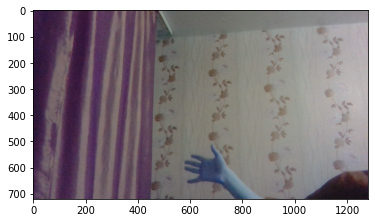

(array([[0.035042 , 0.9649581]], dtype=float32), array([1]))


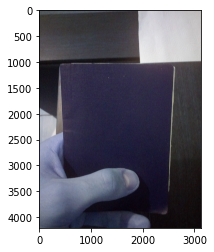

(array([[1.000000e+00, 7.694777e-24]], dtype=float32), array([0]))


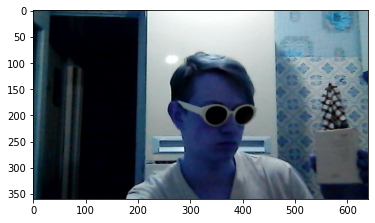

(array([[1.000000e+00, 8.977654e-26]], dtype=float32), array([0]))


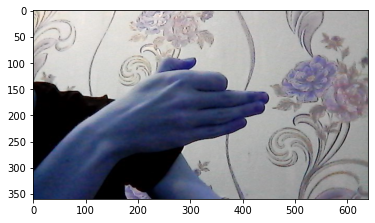

(array([[0.9931687 , 0.00683127]], dtype=float32), array([0]))


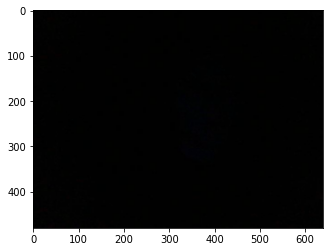

(array([[1.0000000e+00, 4.1371928e-22]], dtype=float32), array([0]))


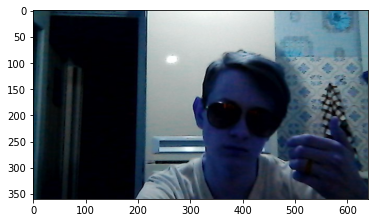

(array([[3.6985330e-05, 9.9996305e-01]], dtype=float32), array([1]))


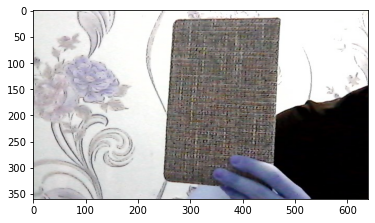

(array([[9.9999988e-01, 1.7249921e-07]], dtype=float32), array([0]))


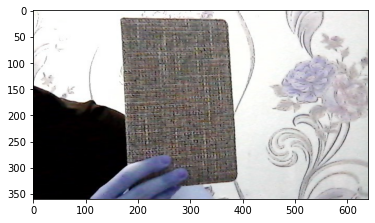

(array([[0.99394023, 0.00605972]], dtype=float32), array([0]))


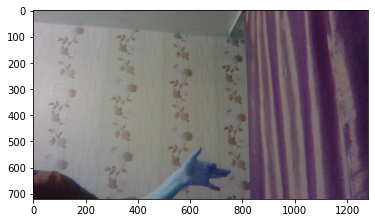

(array([[1.0000000e+00, 5.6859167e-13]], dtype=float32), array([0]))


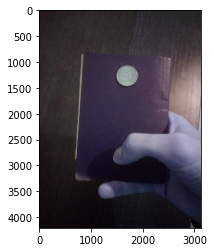

(array([[1.000000e+00, 8.977654e-26]], dtype=float32), array([0]))


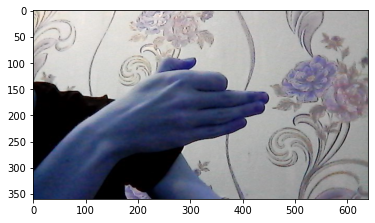

(array([[1.000000e+00, 1.246998e-08]], dtype=float32), array([0]))


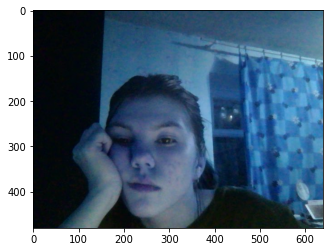

(array([[0.9929507 , 0.00704936]], dtype=float32), array([0]))


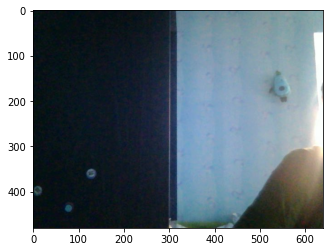

(array([[1.0000000e+00, 7.6999124e-10]], dtype=float32), array([0]))


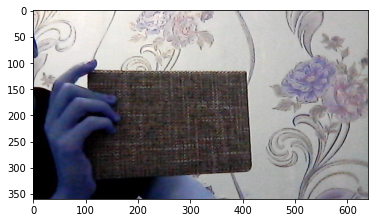

(array([[1.000000e+00, 7.320474e-11]], dtype=float32), array([0]))


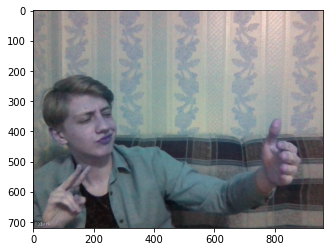

(array([[1.0000000e+00, 2.4322029e-12]], dtype=float32), array([0]))


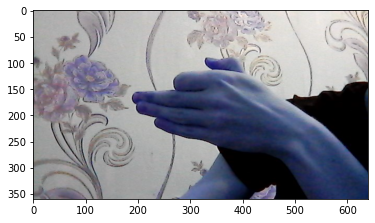

(array([[9.999994e-01, 6.155860e-07]], dtype=float32), array([0]))


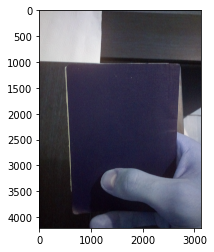

(array([[1.0000000e+00, 4.0007161e-10]], dtype=float32), array([0]))


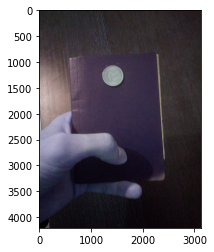

(array([[0.99532324, 0.00467683]], dtype=float32), array([0]))


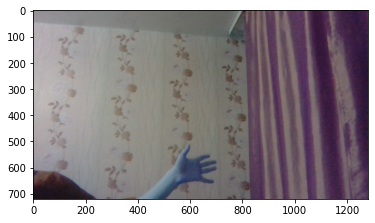

(array([[1.000000e+00, 7.399536e-11]], dtype=float32), array([0]))


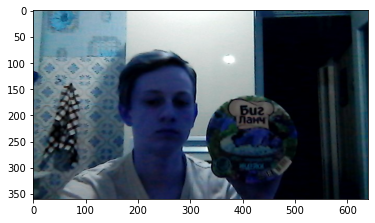

(array([[0.99823356, 0.00176643]], dtype=float32), array([0]))


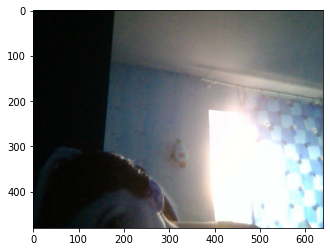

(array([[1.0000000e+00, 2.2550822e-08]], dtype=float32), array([0]))


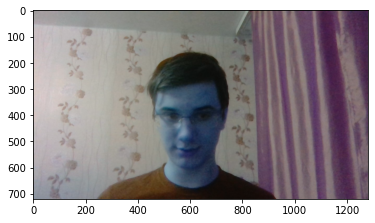

(array([[9.9999940e-01, 5.7131297e-07]], dtype=float32), array([0]))


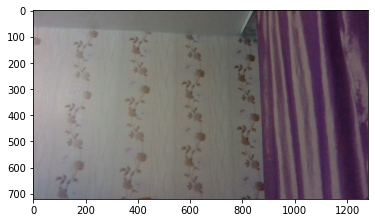

(array([[0.00214665, 0.99785334]], dtype=float32), array([1]))


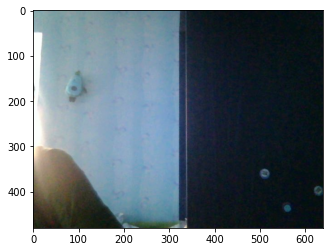

(array([[1.0000000e+00, 1.1059121e-14]], dtype=float32), array([0]))


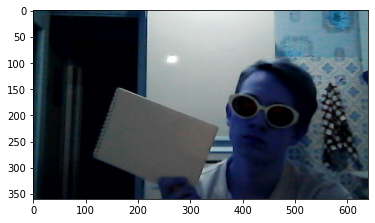

(array([[9.9999952e-01, 5.0611965e-07]], dtype=float32), array([0]))


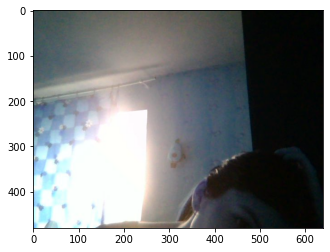

(array([[9.9999893e-01, 1.0805009e-06]], dtype=float32), array([0]))


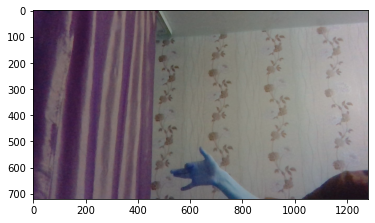

(array([[1.0000000e+00, 3.7811475e-17]], dtype=float32), array([0]))


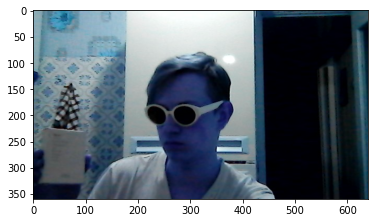

(array([[1.0000000e+00, 1.4012992e-20]], dtype=float32), array([0]))


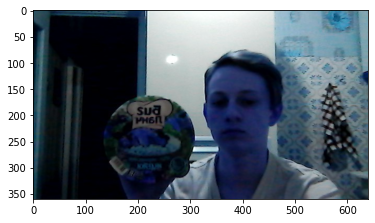

(array([[0.9909348 , 0.00906519]], dtype=float32), array([0]))


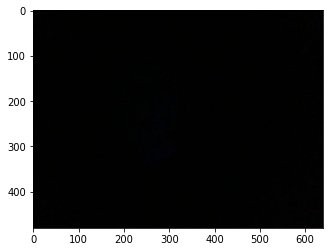

(array([[1.000000e+00, 5.039522e-08]], dtype=float32), array([0]))


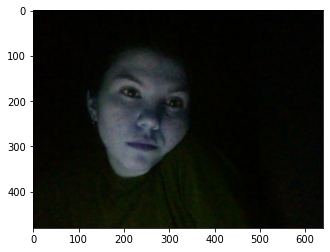

(array([[1.000000e+00, 4.591778e-11]], dtype=float32), array([0]))


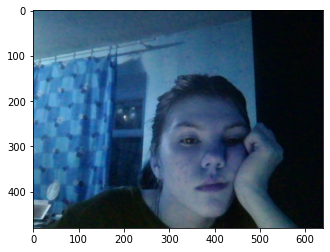

(array([[1.0000000e+00, 1.3929009e-11]], dtype=float32), array([0]))


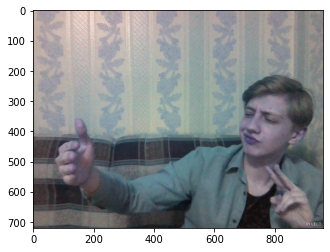

(array([[1.00000e+00, 5.87975e-24]], dtype=float32), array([0]))


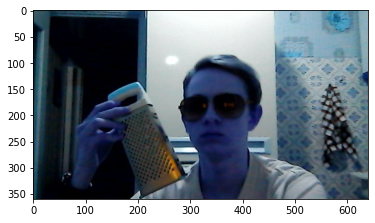

(array([[1.0000000e+00, 2.4322029e-12]], dtype=float32), array([0]))


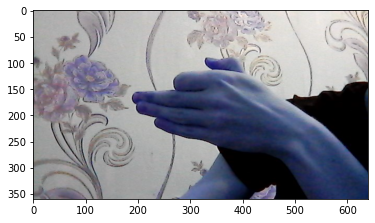

(array([[1.0000000e+00, 2.8831178e-15]], dtype=float32), array([0]))


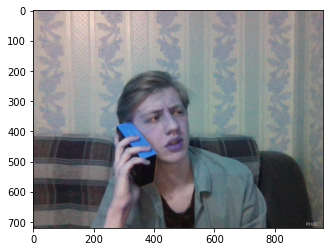

(array([[1.0000000e+00, 3.5847434e-09]], dtype=float32), array([0]))


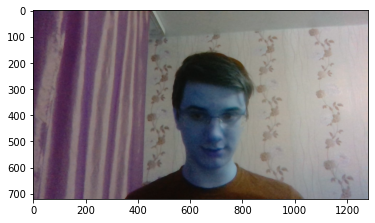

(array([[0.7669788 , 0.23302124]], dtype=float32), array([0]))


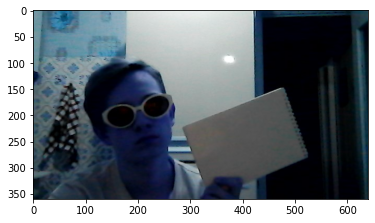

(array([[0.99723935, 0.00276069]], dtype=float32), array([0]))


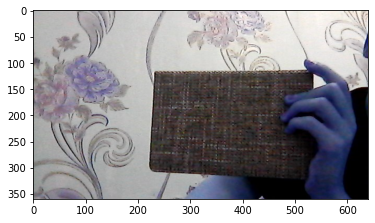

(array([[1.0000000e+00, 6.9362246e-12]], dtype=float32), array([0]))


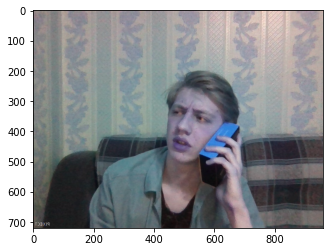

(array([[9.9999976e-01, 2.5769947e-07]], dtype=float32), array([0]))


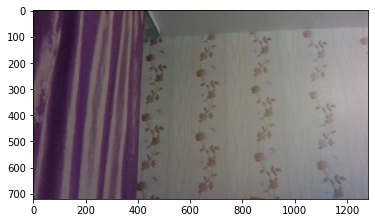

(array([[1.0000000e+00, 3.0428248e-13]], dtype=float32), array([0]))


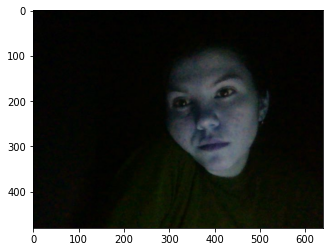

(array([[1.0000000e+00, 4.8058253e-21]], dtype=float32), array([0]))


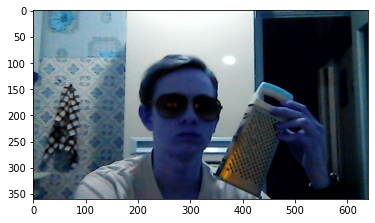

In [76]:
path = '/content/work_test/no_phone'
for root, dirs, files in os.walk(path):
    for file in files:
      p = os.path.join(path, file)
      print(get_predict(p))
      im = cv.imread(p)
      plt.imshow(im)
      plt.show()